In [1]:
%%bash
# If your project has a 'requirements.txt' file, we'll install it here apart from blacklisted packages that interfere with Deepnote (see above).
if test -f requirements.txt
  then
    sed -i '/jedi/d;/jupyter/d;' ./requirements.txt
    pip install -r ./requirements.txt
  else echo "There's no requirements.txt, so nothing to install. This is the case with most projects."
fi

Couldn't find program: 'bash'


In [2]:
import scipy

In [4]:
import numpy

In [7]:
import mkl

ModuleNotFoundError: No module named 'mkl'

In [1]:
import face_recognition

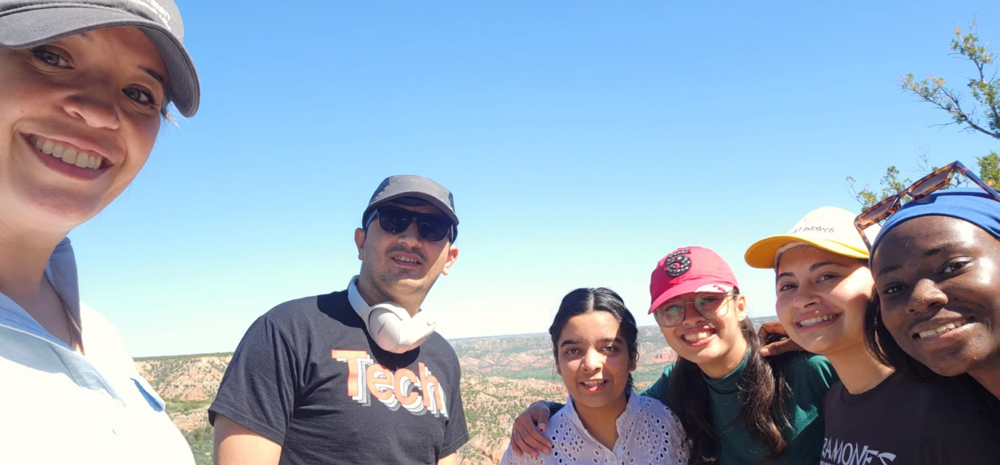

In [2]:
from PIL import Image, ImageDraw
from IPython.display import display

# The program we will be finding faces on the example below
pil_im = Image.open('six.jpg')
display(pil_im)

In [43]:
import face_recognition
import numpy as np
from PIL import Image, ImageDraw
from IPython.display import display

# This is an example of running face recognition on a single image
# and drawing a box around each person that was identified.

# Load a sample picture and learn how to recognize it.
gargi_image = face_recognition.load_image_file("gargi.jpg")
gargi_face_encoding = face_recognition.face_encodings(gargi_image)[0]

# Load a second sample picture and learn how to recognize it.
muskan_image = face_recognition.load_image_file("muskan.jpg")
muskan_face_encoding = face_recognition.face_encodings(muskan_image)[0]

tahmina_image = face_recognition.load_image_file("tahmina.jpg")
tahmina_face_encoding = face_recognition.face_encodings(tahmina_image)[0]

kat_image = face_recognition.load_image_file("kat.jpg")
kat_face_encoding = face_recognition.face_encodings(kat_image)[0]

parth_image = face_recognition.load_image_file("parth.jpg")
parth_face_encoding = face_recognition.face_encodings(parth_image)[0]


bd_image = face_recognition.load_image_file("bigdawg.jpg")
bd_face_encoding = face_recognition.face_encodings(bd_image)[0]

# Create arrays of known face encodings and their names
known_face_encodings = [
    gargi_face_encoding,
    muskan_face_encoding,
    tahmina_face_encoding,
    kat_face_encoding,
    parth_face_encoding,
    bd_face_encoding
]
known_face_names = [
    "Gargi",
    "Muskan",
    "Tahmina",
    "Kat",
    "Parth",
    "Big Dawg"
]
print('Learned encoding for', len(known_face_encodings), 'images.')

Learned encoding for 6 images.


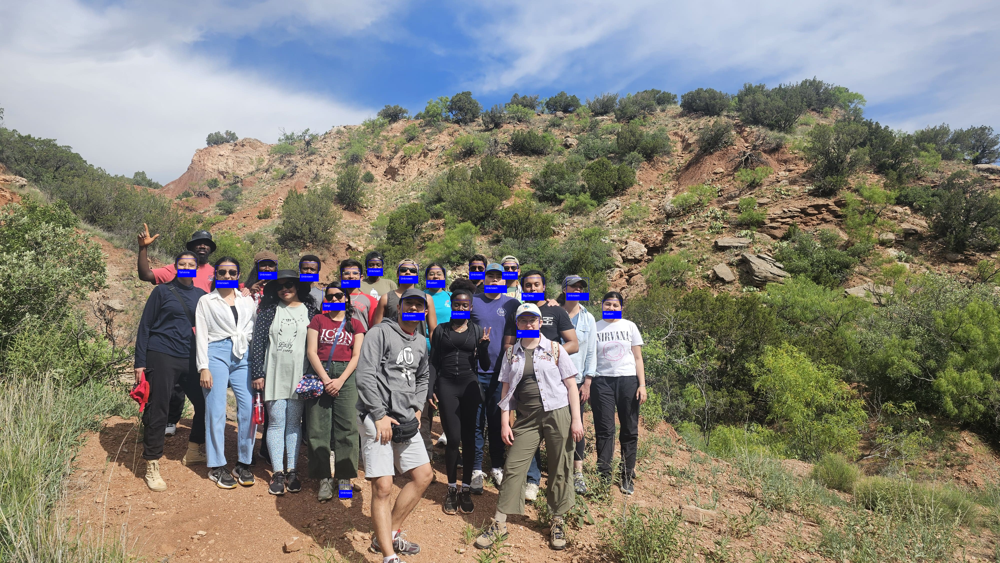

In [44]:
# Load an image with an unknown face
unknown_image = face_recognition.load_image_file("mega.jpg")

# Find all the faces and face encodings in the unknown image
face_locations = face_recognition.face_locations(unknown_image)
face_encodings = face_recognition.face_encodings(unknown_image, face_locations)

# Convert the image to a PIL-format image so that we can draw on top of it with the Pillow library
# See http://pillow.readthedocs.io/ for more about PIL/Pillow
pil_image = Image.fromarray(unknown_image)
# Create a Pillow ImageDraw Draw instance to draw with
draw = ImageDraw.Draw(pil_image)

# Loop through each face found in the unknown image
for (top, right, bottom, left), face_encoding in zip(face_locations, face_encodings):
    # See if the face is a match for the known face(s)
    matches = face_recognition.compare_faces(known_face_encodings, face_encoding)

    name = "Unknown"

    # Or instead, use the known face with the smallest distance to the new face
    face_distances = face_recognition.face_distance(known_face_encodings, face_encoding)
    best_match_index = np.argmin(face_distances)
    if matches[best_match_index]:
        name = known_face_names[best_match_index]

    # Draw a box around the face using the Pillow module
    draw.rectangle(((left, top), (right, bottom)), outline=(0, 0, 255))

    # Draw a label with a name below the face
    text_width= 20
    text_height= 20

    draw.rectangle(((left, bottom - text_height - 10), (right, bottom)), fill=(0, 0, 255), outline=(0, 0, 255))
    draw.text((left + 6, bottom - text_height - 5), name, fill=(255, 255, 255, 255))
    


# Remove the drawing library from memory as per the Pillow docs
del draw

# Display the resulting image
display(pil_image)